In [10]:
import librosa.display
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt

## Loading audio files with Librosa

In [11]:
scale_file = 'audio/scale.wav'
debussy_file = 'audio/debussy.wav'
redhot_file = 'audio/redhot.wav'
duke_file = 'audio/duke.wav'

In [12]:
ipd.Audio(scale_file)

In [13]:
ipd.Audio(debussy_file)

In [14]:
ipd.Audio(redhot_file)

In [15]:
ipd.Audio(duke_file)

In [16]:
# load audio files with librosa
scale, sr = librosa.load(scale_file)
debussy, _ = librosa.load(debussy_file)
redhot, _ = librosa.load(redhot_file)
duke, _ = librosa.load(duke_file)

## Extracting Short-Time Fourier Transform

In [17]:
FRAME_SIZE = 2048
HOP_SIZE = 512

In [18]:
S_scale = librosa.stft(scale, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)

In [19]:
S_scale.shape

(1025, 342)

In [20]:
type(S_scale[0][0])

numpy.complex64

## Calculating the spectrogram

In [80]:
Y_scale = np.abs(S_scale) ** 2

In [22]:
Y_scale.shape

(1025, 342)

In [23]:
type(Y_scale[0][0])

numpy.float32

## Visualizing the spectrogram

In [24]:
def plot_spectrogram(Y, sr, hop_length, y_axis='linear'):
    plt.figure(figsize=(25, 10))
    librosa.display.specshow(Y, 
                             sr=sr, 
                             hop_length=hop_length, 
                             x_axis='time', 
                             y_axis=y_axis)
    plt.colorbar(format='%+2.f')

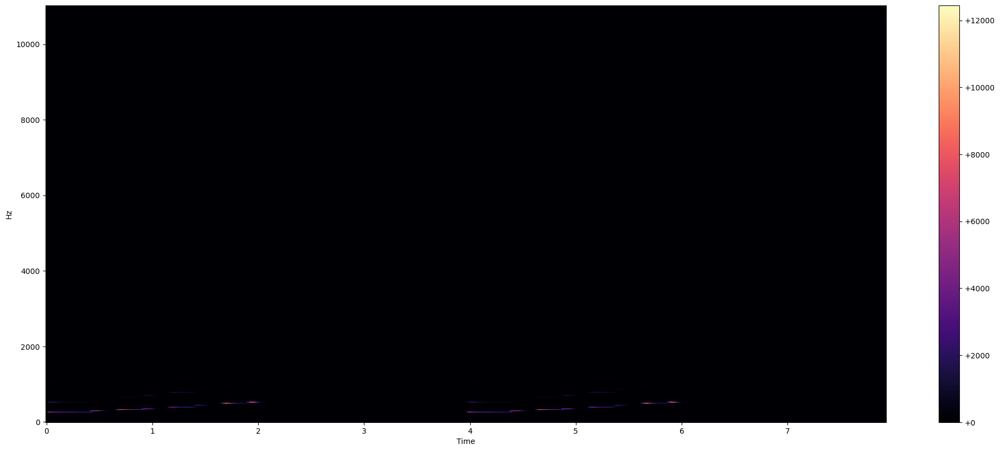

In [25]:
plot_spectrogram(Y_scale, sr, HOP_SIZE)

## Log-Amplitude Spectrogram

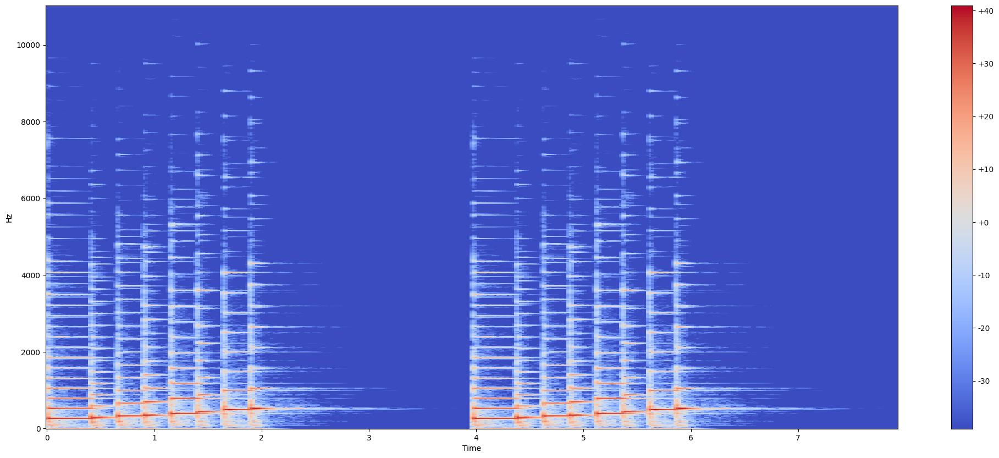

In [17]:
Y_log_scale = librosa.power_to_db(Y_scale)
plot_spectrogram(Y_log_scale, sr, HOP_SIZE)

## Log-Frequency Spectrogram

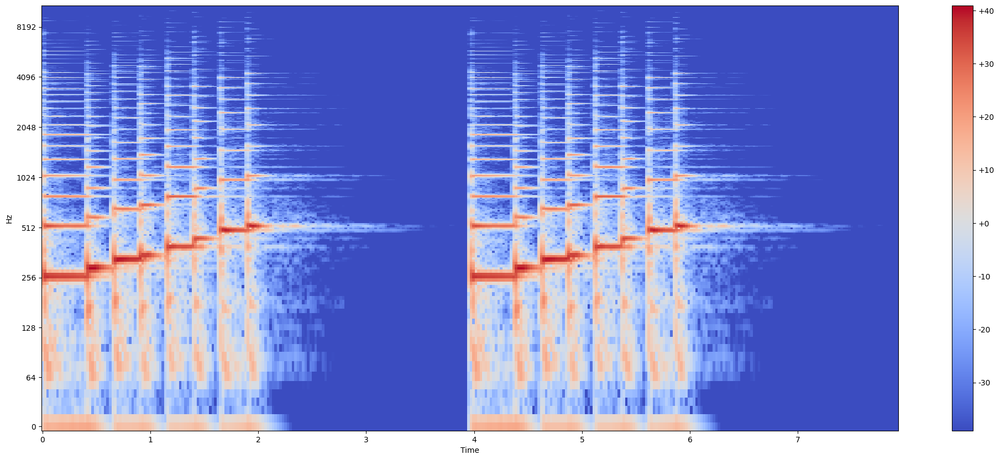

In [18]:
plot_spectrogram(Y_log_scale, sr, HOP_SIZE, y_axis='log')

## Visualising songs from different genres

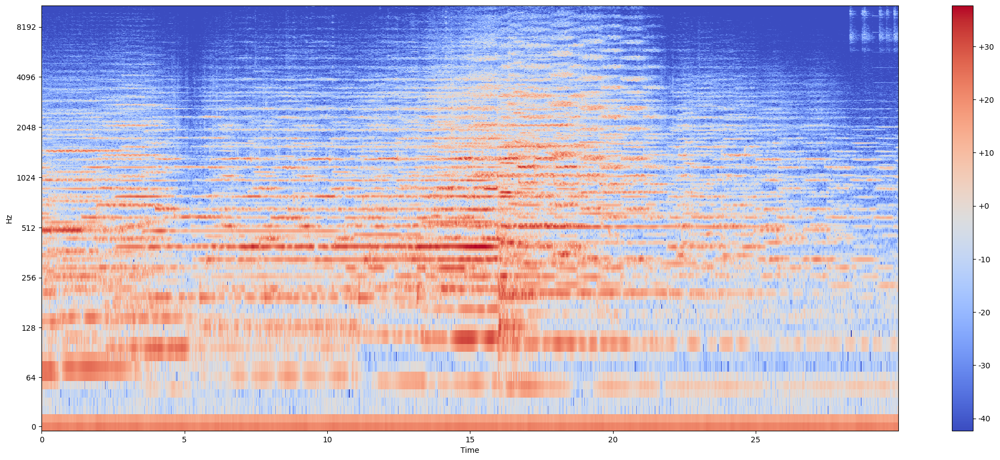

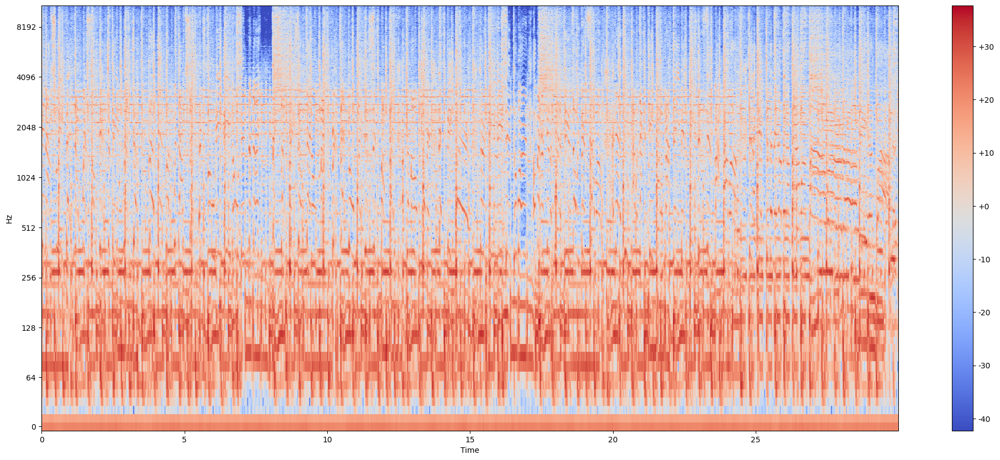

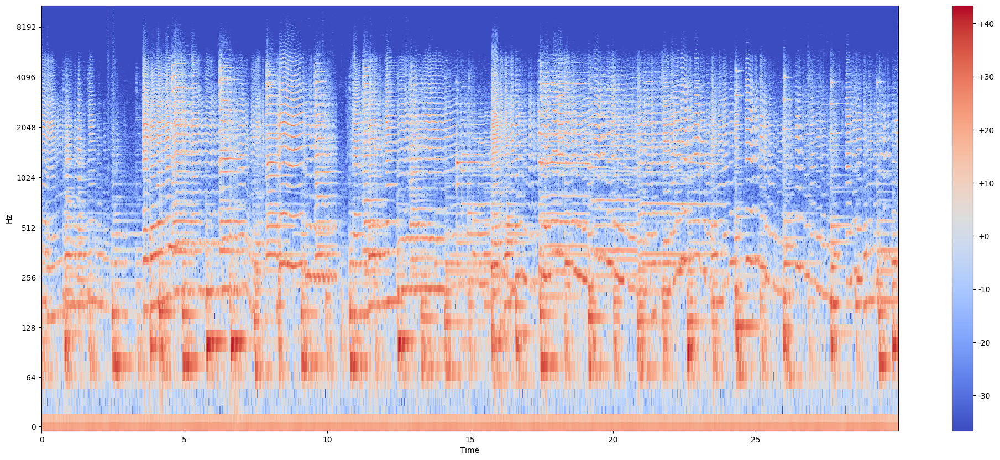

In [19]:
S_debussy = librosa.stft(debussy, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
S_redhot = librosa.stft(redhot, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
S_duke = librosa.stft(duke, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)


Y_debussy = librosa.power_to_db(np.abs(S_debussy) ** 2)
Y_redhot = librosa.power_to_db(np.abs(S_redhot) ** 2)
Y_duke = librosa.power_to_db(np.abs(S_duke) ** 2)

plot_spectrogram(Y_debussy, sr, HOP_SIZE, y_axis='log')
plot_spectrogram(Y_redhot, sr, HOP_SIZE, y_axis='log')
plot_spectrogram(Y_duke, sr, HOP_SIZE, y_axis='log')

## Extracting Short-Time Fourier Transform with Torch and Torchaudio

In [74]:
import torchaudio

%matplotlib inline

In [27]:
scale_file = 'audio/scale.wav'
debussy_file = 'audio/debussy.wav'
redhot_file = 'audio/redhot.wav'
duke_file = 'audio/duke.wav'

In [33]:
scale_torchaudio, sr_torchaudio = torchaudio.load(scale_file)
scale_resampler = torchaudio.transforms.Resample(orig_freq=sr_torchaudio, new_freq=sr)
scale_torchaudio = scale_resampler(scale_torchaudio.mean(dim=0).unsqueeze(0))

sr_torchaudio = sr

In [35]:
print(scale_torchaudio.shape)
print(scale_torchaudio.dim())

torch.Size([1, 174943])
2


In [36]:
# duration in seconds of 1 sample
sample_duration = 1 / sr_torchaudio
print(f'One sample lasts for {sample_duration:.8f} seconds')

One sample lasts for 0.00004535 seconds


In [37]:
# total number of samples in audio file
tot_samples = scale_torchaudio.size(1)
print(tot_samples)

174943


In [38]:
# duration of debussy audio in seconds
duration = 1 / sr_torchaudio * tot_samples
print(f'The audio lasts for {duration} seconds')

The audio lasts for 7.933922902494332 seconds


In [91]:
stft_transform = torchaudio.transforms.Spectrogram(n_fft=FRAME_SIZE, hop_length=HOP_SIZE, pad_mode='constant')
Y_scale_torchaudio = stft_transform(scale_torchaudio).squeeze(0)

In [83]:
print(Y_scale_torchaudio.shape)

torch.Size([1025, 342])


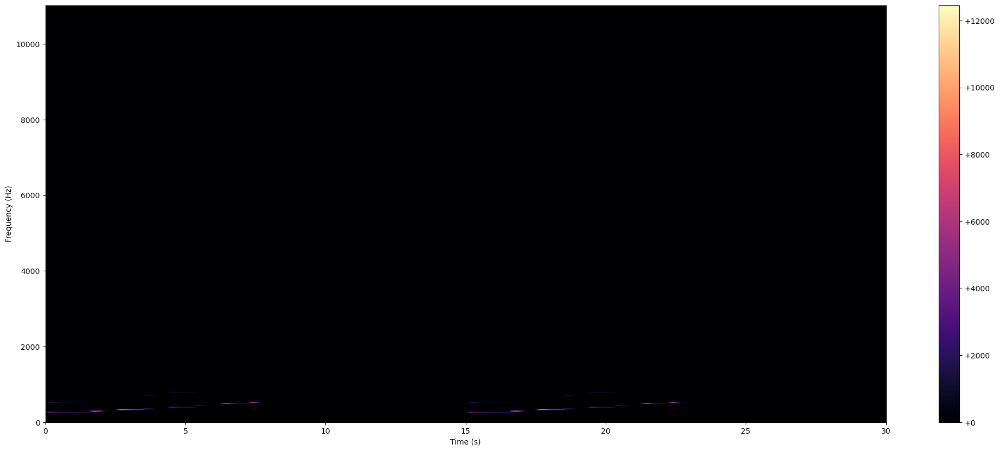

In [120]:
plt.figure(figsize=(25, 10))
plt.imshow(Y_scale_torchaudio, aspect='auto', origin='lower', cmap='magma', extent=(0, duration, 0, sr_torchaudio // 2))
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(format='%+2.f')
plt.show()

In [86]:
spectrogram_transform = torchaudio.transforms.AmplitudeToDB(stype='power', top_db=80)
Y_log_scale_torchaudio = spectrogram_transform(Y_scale_torchaudio).squeeze(0)

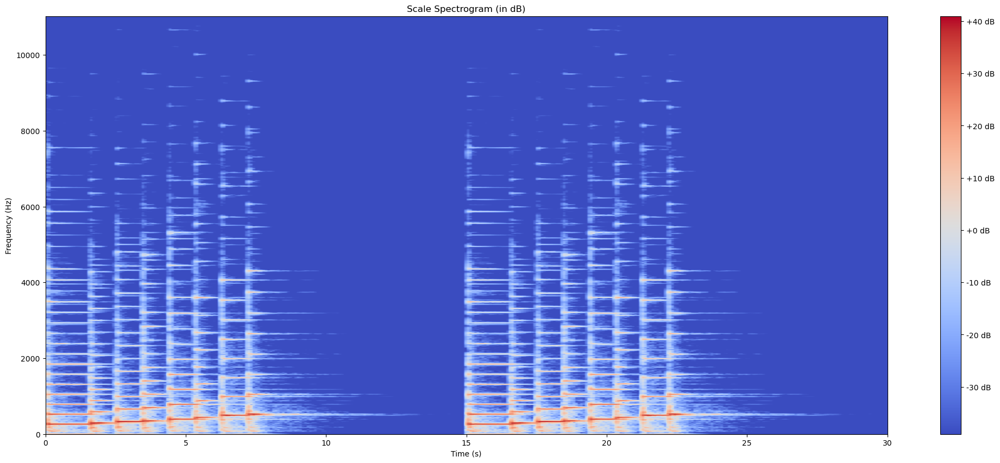

In [118]:
plt.figure(figsize=(25, 10))
plt.imshow(Y_log_scale_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 0, sr_torchaudio / 2))
plt.colorbar(format='%+2.f dB')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.title('Scale Spectrogram (in dB)')
plt.show()

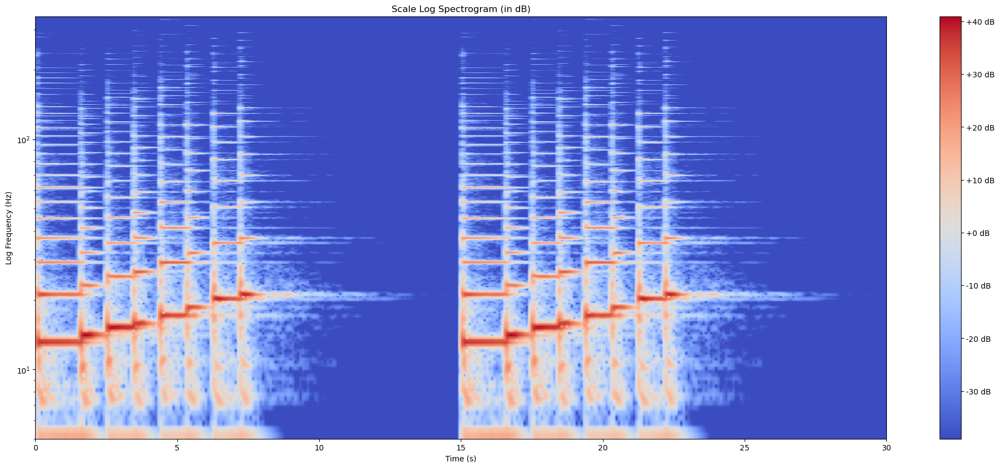

In [119]:
plt.figure(figsize=(25, 10))
plt.yscale('log')
plt.imshow(Y_log_scale_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 5, Y_log_scale_torchaudio.size(1)))
plt.colorbar(format='%+2.f dB')
plt.xlabel('Time (s)')
plt.ylabel('Log Frequency (Hz)')
plt.title('Scale Log Spectrogram (in dB)')
plt.show()

In [114]:
debussy_torchaudio, _ = torchaudio.load(debussy_file)
redhot_torchaudio, _ = torchaudio.load(redhot_file)
duke_torchaudio, _ = torchaudio.load(duke_file)

In [115]:
print(debussy_torchaudio.shape)
print(debussy_torchaudio.dim())

torch.Size([1, 661500])
2


In [116]:
# total number of samples in audio file
tot_samples = debussy_torchaudio.size(1)
print(tot_samples)

661500


In [117]:
# duration of debussy audio in seconds
duration = 1 / sr_torchaudio * tot_samples
print(f'The audio lasts for {duration} seconds')

The audio lasts for 30.0 seconds


In [121]:
Y_debussy_torchaudio = stft_transform(debussy_torchaudio).squeeze(0)
Y_redhot_torchaudio = stft_transform(redhot_torchaudio).squeeze(0)
Y_duke_torchaudio = stft_transform(duke_torchaudio).squeeze(0)

Y_log_debussy_torchaudio = spectrogram_transform(Y_debussy_torchaudio).squeeze(0)
Y_log_redhot_torchaudio = spectrogram_transform(Y_redhot_torchaudio).squeeze(0)
Y_log_duke_torchaudio = spectrogram_transform(Y_duke_torchaudio).squeeze(0)

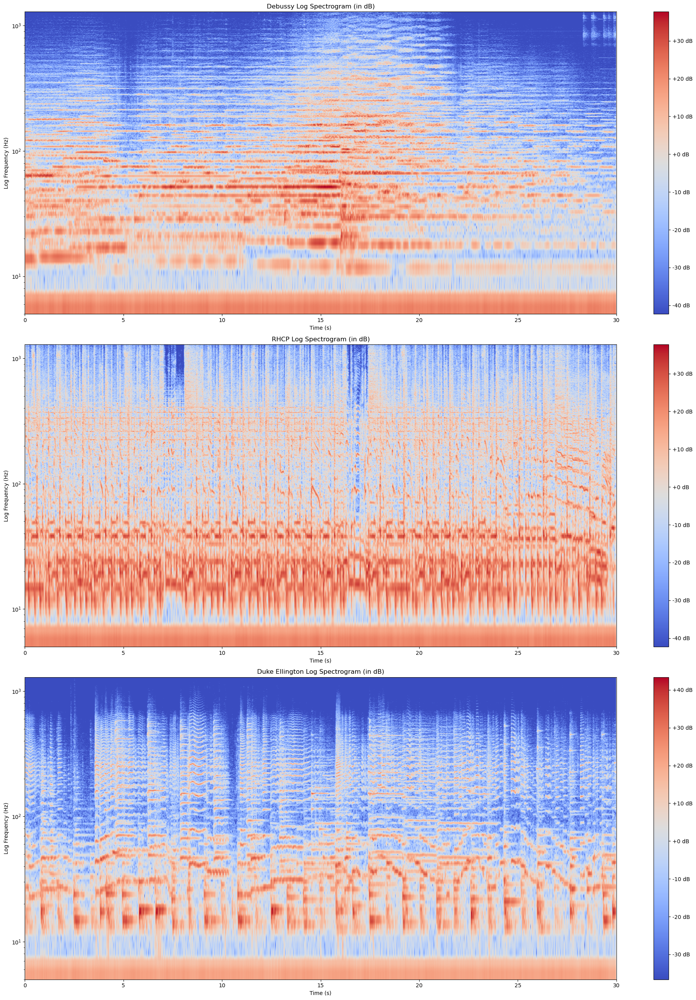

In [126]:
plt.figure(figsize=(20, 26))

# Debussy
plt.subplot(3, 1, 1)
plt.yscale('log')
plt.imshow(Y_log_debussy_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 5, Y_log_debussy_torchaudio.size(1)))
plt.colorbar(format='%+2.f dB')
plt.title('Debussy Log Spectrogram (in dB)')
plt.xlabel('Time (s)')
plt.ylabel('Log Frequency (Hz)')

# Redhot
plt.subplot(3, 1, 2)
plt.yscale('log')
plt.imshow(Y_log_redhot_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 5, Y_log_redhot_torchaudio.size(1)))
plt.colorbar(format='%+2.f dB')
plt.title('RHCP Log Spectrogram (in dB)')
plt.xlabel('Time (s)')
plt.ylabel('Log Frequency (Hz)')

# Duke
plt.subplot(3, 1, 3)
plt.yscale('log')
plt.imshow(Y_log_duke_torchaudio, aspect='auto', origin='lower', cmap='coolwarm', extent=(0, duration, 5, Y_log_duke_torchaudio.size(1)))
plt.colorbar(format='%+2.f dB')
plt.title('Duke Ellington Log Spectrogram (in dB)')
plt.xlabel('Time (s)')
plt.ylabel('Log Frequency (Hz)')

plt.tight_layout()
plt.show()